In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
import numpy as np
import pickle

In [2]:
from NLP_MH import DataIngest

### Utils

In [22]:
def getFeatureImportanceDF(rf_classifier_selected, tfidf_vectorizer):
    feature_importances = rf_classifier_selected.feature_importances_
    actual_feature_names = tfidf_vectorizer.get_feature_names_out()
    # Get the indices of the features with non-zero importances
    selected_feature_indices = feature_importances.nonzero()[0]

    selected_feature_names = [actual_feature_names[i] for i in selected_feature_indices]
    
    feature_importances = rf_classifier_selected.feature_importances_

    feature_names = tfidf_vectorizer.get_feature_names_out()
    feature_importance_dict = dict(zip(feature_names, feature_importances))

    # Step 5: Sort feature importances by their scores
    sorted_feature_importances = sorted(feature_importance_dict.items(), key=lambda x: x[1], reverse=True)

    df_ft_imp2 = pd.DataFrame()
    features = []
    importances = []
    # Step 6: Print or analyze the sorted feature importances
    for feature_name, importance_score in sorted_feature_importances:
        features.append(feature_name)
        importances.append(importance_score)

    df_ft_imp2["feature"] = features
    df_ft_imp2["importance"] = importances
    
    all_names = tfidf_vectorizer.get_feature_names_out()
    actual_names = []
    featureImportance_df = df_ft_imp2
    for ft_code in df_ft_imp2["feature"]:
        index = ft_code[1:]
        actual_names.append(all_names[int(index)])

    featureImportance_df["feature"] = actual_names
    
    return featureImportance_df

In [23]:
def readPickle(picklePath, pickleName):
    the_data_t = pickle.load(open(picklePath + pickleName + ".pk", "rb")) 
    print(the_data_t)
    print('read pickles')
    return the_data_t

In [5]:
df = pd.read_csv("NLP_MH/mh_clean.csv")

In [6]:
df = df.drop(columns=['Unnamed: 0'])

In [7]:
df

,label,body,body_stem_sw
0,Venting,last april after i found out my ex had lied to...,last april found ex lie upset thing complet br...
1,Venting,i have an issue that has affected my life for ...,issu affect life long time i'm 19 year old alw...
2,Venting,i wouldn t even know where to start i know mor...,even know start know wrong confirm time ago so...
3,Venting,well another concert even immediately after i ...,well anoth concert even immedi snap back bpd m...
4,Venting,i just need to get this off my chest i feel li...,need get chest feel like peopl tell lest scare...
...,...,...,...
48880,Need Support,m22 i work full time and i'm trying to fill ou...,m22 work full time i'm tri fill applic grad sc...
48881,Venting,i already made a few posts here but its gettin...,alreadi made post get wors wors everyday feel ...
48882,Need Support,hi all ta account i am forced to live with som...,hi ta account forc live someon narcissist beha...
48883,Venting,yesterday i needed to take the train somewhere...,yesterday need take train somewher stood stati...


In [8]:
nans = df["body"].isna()
nans1 = df["body_stem_sw"].isna()

In [9]:
df = df[~nans]

In [10]:
df = df[~nans1]

/var/folders/fr/g38hffys3lbdjhb5h18vy6nh0000gn/T/ipykernel_6998/388880916.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df = df[~nans1]


In [11]:
filehandler = open("ML_Data/MH_DF.pk","wb")
pickle.dump(df,filehandler)
print("pickle complete")

pickle complete


In [12]:
X_train, X_test, y_train, y_test = train_test_split(df['body'], df['label'], test_size=0.2, random_state=42)

In [14]:
DataIngest.writePickle(X_train, "X_train_rf","ML_Data/")
DataIngest.writePickle(X_test, "X_test_rf","ML_Data/")
DataIngest.writePickle(X_test, "y_train_rf","ML_Data/")
DataIngest.writePickle(X_test, "y_test_rf","ML_Data/")

pickle complete
pickle complete
pickle complete
pickle complete


In [31]:
tfidf_vectorizer = TfidfVectorizer(max_features=10000)  # You can adjust max_features as needed, could you run it with everything? 
#use chi-squared to pick features
X_train_tfidf = tfidf_vectorizer.fit_transform(X_train)
X_test_tfidf = tfidf_vectorizer.transform(X_test)

In [21]:
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train_tfidf, y_train)

RandomForestClassifier(random_state=42)

In [22]:
with open('ML_Models/rf_classifier.pk', 'wb') as file:
    pickle.dump(rf_classifier, file)

In [23]:
predictions = rf_classifier.predict(X_test_tfidf)

In [24]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

Need Support       0.65      0.78      0.70      5168
     Venting       0.67      0.52      0.59      4591

    accuracy                           0.66      9759
   macro avg       0.66      0.65      0.65      9759
weighted avg       0.66      0.66      0.65      9759



In [168]:
tfidf_vectorizer.get_feature_names_out()

array(['00', '000', '10', ..., 'zoning', 'zoo', 'zoom'], dtype=object)

In [169]:
print(tfidf_vectorizer.get_stop_words())

None


### Get Feature Importance 

In [170]:
featureImportance_df = getFeatureImportanceDF(rf_classifier, tfidf_vectorizer)

In [171]:
featureImportance_df

,feature,importance
0,dog,0.007119
1,fucking,0.004973
2,habits,0.004935
3,uk,0.003590
4,overall,0.003515
...,...,...
1527,tasks,0.000000
1528,tv,0.000000
1529,two,0.000000
1530,usual,0.000000


In [172]:
with open('ML_Data/ft_importance1.pk', 'wb') as file:
    pickle.dump(featureImportance_df, file)

### Decision Tree for Random Forest with TFIDF 

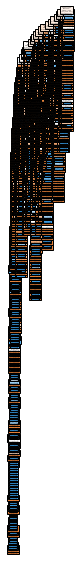

In [173]:
import matplotlib.pyplot as plt
from sklearn import tree

tree_index = 0  # Index of the tree you want to extract
extracted_tree = rf_classifier.estimators_[tree_index]

# Step 4: Visualize the decision tree
plt.figure(figsize=(1, 10))
tree.plot_tree(extracted_tree, feature_names=tfidf_vectorizer.get_feature_names_out(), class_names=["Need Support", "Venting"], filled=True)
plt.show()

### Attempting to get feature importance 

### Feature Engineering: Run random forest on features that perform higher than the average. 

In [80]:
from sklearn.feature_selection import SelectFromModel
from sklearn import tree

feature_importances = rf_classifier.feature_importances_
model = SelectFromModel(rf_classifier, threshold='mean')
X_train_selected = model.fit_transform(X_train_tfidf, y_train)

# Train a new RandomForestClassifier with selected features
rf_classifier_selected = RandomForestClassifier()
rf_classifier_selected.fit(X_train_selected, y_train)

RandomForestClassifier()

In [175]:
with open('ML_Models/rf_classifier_ft.pk', 'wb') as file:
    pickle.dump(rf_classifier1, file)

In [81]:
X_test_selected = model.transform(X_test_tfidf)
predictions = rf_classifier_selected.predict(X_test_selected)

In [82]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

Need Support       0.67      0.76      0.71      5168
     Venting       0.68      0.58      0.62      4591

    accuracy                           0.67      9759
   macro avg       0.67      0.67      0.67      9759
weighted avg       0.67      0.67      0.67      9759



In [179]:
featureImportance_df_FE = getFeatureImportanceDF(rf_classifier_selected, tfidf_vectorizer)

In [180]:
featureImportance_df_FE["importance"].max()

0.010646273265515928

In [181]:
filehandler = open("ML_Data/ft_importance1_ft.pk","wb")
pickle.dump(featureImportance_df_FE,filehandler)
print("pickle complete")

pickle complete


In [182]:
featureImportance_df_FE.head(50)

,feature,importance
0,advice,0.010646
1,please,0.009463
2,help,0.008762
3,just,0.007587
4,vent,0.006695
5,any,0.006066
6,and,0.005938
7,do,0.005934
8,to,0.005821
9,it,0.005552


### Train Random Forest on text without stop words 

In [183]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(df['body_stem_sw'], df['label'], test_size=0.2, random_state=42)

In [184]:
tfidf_vectorizer1 = TfidfVectorizer(max_features=10000)  # You can adjust max_features as needed
X_train_tfidf1 = tfidf_vectorizer1.fit_transform(X_train1)
X_test_tfidf1 = tfidf_vectorizer1.transform(X_test1)

In [185]:
rf_classifier1 = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier1.fit(X_train_tfidf1, y_train1)

RandomForestClassifier(random_state=42)

In [186]:
with open('ML_Models/rf_classifier_no_stp.pk', 'wb') as file:
    pickle.dump(rf_classifier1, file)

In [187]:
predictions1 = rf_classifier1.predict(X_test_tfidf1)

In [188]:
print(classification_report(y_test1, predictions1))

              precision    recall  f1-score   support

Need Support       0.65      0.77      0.70      5168
     Venting       0.67      0.53      0.59      4591

    accuracy                           0.66      9759
   macro avg       0.66      0.65      0.65      9759
weighted avg       0.66      0.66      0.65      9759



### Feature Engineering 

Removing stop words reduced the accuracy of Venting, but only by a percentage 

In [189]:
from sklearn.feature_selection import SelectFromModel
from sklearn import tree

feature_importances1 = rf_classifier1.feature_importances_
model1 = SelectFromModel(rf_classifier1, threshold='mean')
X_train_selected1 = model1.fit_transform(X_train_tfidf1, y_train1)

# Train a new RandomForestClassifier with selected features
rf_classifier_selected1 = RandomForestClassifier()
rf_classifier_selected1.fit(X_train_selected1, y_train1)

RandomForestClassifier()

In [190]:
X_test_selected1 = model1.transform(X_test_tfidf1)
predictions1_ft = rf_classifier_selected1.predict(X_test_selected1)

In [191]:
with open('ML_Models/rf_classifier_no_stp_ft.pk', 'wb') as file:
    pickle.dump(rf_classifier_selected1, file)

In [192]:
print(classification_report(y_test1, predictions1_ft))

              precision    recall  f1-score   support

Need Support       0.66      0.76      0.71      5168
     Venting       0.67      0.56      0.61      4591

    accuracy                           0.66      9759
   macro avg       0.67      0.66      0.66      9759
weighted avg       0.67      0.66      0.66      9759



In [193]:
tfidf_vectorizer1.get_feature_names_out()

array(['00', '000', '00am', ..., 'zoom', 'zopiclon', 'zyprexa'],
      dtype=object)

In [194]:
featureImportance_noStp_df = getFeatureImportanceDF(rf_classifier_selected1, tfidf_vectorizer1)

In [195]:
featureImportance_noStp_df

,feature,importance
0,ach,0.014469
1,hormon,0.012077
2,wimp,0.010773
3,playdat,0.010405
4,grandmother,0.007923
...,...,...
1527,overheard,0.000086
1528,whiney,0.000081
1529,surgeri,0.000079
1530,got,0.000077


In [198]:
with open('ML_Data/featureImportance_noStp_ft.pk', 'wb') as file:
    pickle.dump(featureImportance_noStp_df, file)

### Random Forest with Word Embeddings

In [6]:
mh_df = DataIngest.readPickle("ML_Data/", "MH_DF")

              label                                               body  \
0           Venting  last april after i found out my ex had lied to...   
1           Venting  i have an issue that has affected my life for ...   
2           Venting  i wouldn t even know where to start i know mor...   
3           Venting  well another concert even immediately after i ...   
4           Venting  i just need to get this off my chest i feel li...   
...             ...                                                ...   
48880  Need Support  m22 i work full time and i'm trying to fill ou...   
48881       Venting  i already made a few posts here but its gettin...   
48882  Need Support  hi all ta account i am forced to live with som...   
48883       Venting  yesterday i needed to take the train somewhere...   
48884  Need Support  my mental health has been going bad this year ...   

                                            body_stem_sw  
0      last april found ex lie upset thing complet b

In [10]:
from gensim.models import Word2Vec
import gensim
from nltk.tokenize import sent_tokenize, word_tokenize

In [16]:
mh_df['body_token'] = mh_df['body'].apply(lambda x: list(gensim.utils.tokenize(x)))

In [17]:
mh_df.head()

,label,body,body_stem_sw,body_token
0,Venting,last april after i found out my ex had lied to...,last april found ex lie upset thing complet br...,"[last, april, after, i, found, out, my, ex, ha..."
1,Venting,i have an issue that has affected my life for ...,issu affect life long time i'm 19 year old alw...,"[i, have, an, issue, that, has, affected, my, ..."
2,Venting,i wouldn t even know where to start i know mor...,even know start know wrong confirm time ago so...,"[i, wouldn, t, even, know, where, to, start, i..."
3,Venting,well another concert even immediately after i ...,well anoth concert even immedi snap back bpd m...,"[well, another, concert, even, immediately, af..."
4,Venting,i just need to get this off my chest i feel li...,need get chest feel like peopl tell lest scare...,"[i, just, need, to, get, this, off, my, chest,..."


In [20]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(mh_df['body_token'], mh_df['label'] , test_size=0.2)

In [21]:
w2v_model = gensim.models.Word2Vec(X_train3,
                                   vector_size=100,
                                   window=5,
                                   min_count=2)

In [22]:
w2v_model.wv.index_to_key


['i',
 'to',
 'and',
 'my',
 'the',
 'a',
 'it',
 't',
 'of',
 'me',
 'that',
 'in',
 'but',
 'm',
 'for',
 'have',
 'just',
 'is',
 'was',
 'this',
 'with',
 'like',
 'so',
 's',
 'don',
 'feel',
 'not',
 'can',
 'on',
 'be',
 'do',
 'or',
 'about',
 'she',
 'at',
 'know',
 'because',
 'all',
 'what',
 'they',
 'if',
 've',
 'as',
 'get',
 'been',
 'want',
 'he',
 'when',
 'out',
 'up',
 'her',
 'myself',
 'am',
 'even',
 'you',
 'time',
 'had',
 'really',
 'how',
 'now',
 'life',
 'people',
 'from',
 'them',
 'no',
 'are',
 'would',
 'one',
 'things',
 'we',
 'there',
 'has',
 'think',
 'help',
 'being',
 'more',
 'go',
 'much',
 'an',
 'going',
 'never',
 'some',
 'him',
 'friends',
 'then',
 'something',
 'only',
 'any',
 'who',
 'day',
 'will',
 'always',
 'anything',
 'years',
 'back',
 'also',
 'still',
 'got',
 'work',
 'everything',
 'very',
 'other',
 'mental',
 'need',
 'after',
 'make',
 'bad',
 'by',
 'too',
 'school',
 'way',
 'over',
 'could',
 'didn',
 'feeling',
 'sinc

In [23]:
w2v_model.wv.most_similar('advice')

[('tips', 0.8598355650901794),
 ('suggestions', 0.8389816880226135),
 ('insight', 0.8251371383666992),
 ('advise', 0.7692704200744629),
 ('advices', 0.745142936706543),
 ('input', 0.7392985820770264),
 ('feedback', 0.7099843621253967),
 ('guidance', 0.7065480947494507),
 ('ideas', 0.663114070892334),
 ('suggestion', 0.6590057015419006)]

In [24]:
w2v_model.wv.most_similar('please')

[('pls', 0.8091546893119812),
 ('plz', 0.6861826777458191),
 ('edit', 0.5428728461265564),
 ('need', 0.5081830620765686),
 ('willing', 0.4789172112941742),
 ('sincerely', 0.45606446266174316),
 ('ps', 0.45395079255104065),
 ('tldr', 0.45150020718574524),
 ('wanna', 0.4497155249118805),
 ('pleae', 0.44836363196372986)]

In [25]:
w2v_model.wv.most_similar('vent')

[('rant', 0.8211889863014221),
 ('venting', 0.7244675159454346),
 ('ramble', 0.6169015169143677),
 ('post', 0.6134132742881775),
 ('share', 0.6028946042060852),
 ('write', 0.5882013440132141),
 ('rambling', 0.58598393201828),
 ('talk', 0.5673444867134094),
 ('ranting', 0.5641799569129944),
 ('reddit', 0.5451051592826843)]

In [29]:
words = set(w2v_model.wv.index_to_key )
X_train_vect = np.array([np.array([w2v_model.wv[i] for i in ls if i in words])
                         for ls in X_train3])
X_test_vect = np.array([np.array([w2v_model.wv[i] for i in ls if i in words])
                         for ls in X_test3])

/var/folders/fr/g38hffys3lbdjhb5h18vy6nh0000gn/T/ipykernel_10364/1339252227.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X_train_vect = np.array([np.array([w2v_model.wv[i] for i in ls if i in words])
/var/folders/fr/g38hffys3lbdjhb5h18vy6nh0000gn/T/ipykernel_10364/1339252227.py:4: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X_test_vect = np.array([np.array([w2v_model.wv[i] for i in ls if i in words])


In [31]:
for i, v in enumerate(X_train_vect):
    print(len(X_train3.iloc[i]), len(v))

12 12
575 575
460 460
823 822
177 177
67 67
97 97
246 245
87 87
327 327
151 151
1705 1699
316 316
82 82
74 74
40 40
138 137
78 77
278 278
132 131
326 326
24 24
316 313
170 170
348 348
318 318
767 765
428 426
243 243
110 110
12 12
33 33
167 167
193 193
165 165
129 128
614 613
19 19
239 239
276 276
237 235
203 203
141 141
181 181
164 163
37 37
42 42
49 49
31 31
186 186
437 432
182 182
114 114
167 167
241 241
243 241
142 142
5 5
123 123
141 141
129 129
134 134
115 115
67 67
95 95
153 152
15 15
138 138
126 126
478 478
324 324
141 141
603 602
475 472
3 3
83 83
10 10
172 171
231 231
229 229
396 395
162 161
157 157
212 212
89 89
425 425
575 571
33 33
120 120
95 95
22 22
24 24
94 94
31 31
118 118
519 518
125 125
89 87
227 227
250 250
221 221
201 200
127 126
81 80
248 248
277 277
274 271
123 123
48 48
222 222
959 958
247 247
1127 1127
198 198
90 90
72 72
441 441
105 104
69 69
52 52
224 224
203 203
204 204
351 351
277 276
392 392
80 80
561 561
85 85
11 11
555 554
194 194
263 263
122 122
488 488


115 115
41 38
61 61
84 84
170 170
84 84
91 91
88 88
150 150
398 397
97 97
2175 2172
96 96
420 418
388 386
128 128
77 77
70 70
544 544
600 599
230 230
90 90
324 323
866 866
102 102
887 882
221 221
123 123
9 9
307 305
470 459
312 311
35 35
154 154
330 330
373 373
429 429
147 147
120 120
670 670
336 333
306 306
4 4
526 521
282 282
2 2
59 59
210 210
610 607
416 416
269 269
189 189
397 397
533 531
335 335
94 94
64 64
55 54
87 87
142 142
3486 3481
162 162
220 220
247 247
308 305
212 212
246 246
178 178
283 280
608 607
1071 1071
30 30
494 493
548 548
265 265
12 12
175 175
357 356
430 430
168 167
103 103
179 178
91 91
507 505
598 598
317 317
308 308
117 117
299 298
363 362
417 415
106 106
181 181
40 40
536 534
241 241
210 210
18 18
58 58
108 108
708 708
263 263
104 104
289 289
499 499
97 97
862 862
828 827
146 146
395 395
487 487
115 115
57 56
611 610
568 568
27 27
232 231
15 15
122 122
72 70
248 247
345 345
119 119
330 329
331 330
895 893
74 73
449 449
142 142
76 76
65 65
36 35
172 172
89 89


298 298
260 259
53 52
502 502
827 824
208 208
93 93
148 146
128 128
292 292
221 221
231 230
51 51
18 18
462 461
209 209
6 6
239 239
122 122
327 325
637 637
236 236
440 440
280 279
308 308
826 825
668 668
358 358
275 275
408 408
107 107
112 112
353 352
252 249
143 143
234 233
306 306
163 162
6 5
252 252
133 133
1260 1260
255 254
122 122
242 242
1031 1027
130 130
143 143
516 514
135 135
122 122
1244 1244
523 523
262 261
149 149
111 110
1122 1112
174 174
89 89
203 203
74 74
196 196
265 265
107 106
94 94
579 578
404 404
243 242
745 744
102 102
290 288
39 39
114 114
153 153
120 120
1418 1416
173 173
225 225
252 251
123 123
113 113
145 145
204 204
8 8
114 114
92 92
73 73
113 113
147 147
687 687
153 152
514 514
69 69
127 127
136 136
153 153
190 189
280 280
154 154
336 335
145 143
216 216
183 183
387 387
761 760
225 225
296 295
188 188
2045 2044
434 433
17 17
462 462
218 218
295 295
357 356
403 398
161 161
766 766
110 110
46 46
721 718
10 10
167 166
29 29
79 79
423 423
463 460
56 56
210 210
36

73 73
468 468
178 178
870 870
25 25
265 265
188 188
107 107
684 683
544 544
877 875
238 238
256 256
344 342
27 26
268 267
161 161
3 3
85 85
97 97
198 198
415 415
280 279
307 307
542 542
175 174
138 138
175 175
118 118
475 474
155 154
113 113
222 222
99 99
562 561
1 1
148 148
263 263
115 115
75 75
193 193
63 63
56 56
728 726
381 381
102 102
299 299
227 227
20 20
168 167
100 100
6 6
602 602
74 74
111 111
181 181
247 247
154 154
143 143
437 437
305 305
242 242
125 124
237 237
331 331
222 221
109 109
171 171
266 266
56 56
185 185
163 163
160 160
87 87
598 595
151 151
61 58
208 207
83 83
172 172
472 468
144 144
308 308
232 232
101 101
168 166
89 89
380 379
160 160
146 146
170 169
153 153
178 178
77 76
164 164
233 233
51 51
474 474
73 73
377 377
919 915
170 170
141 140
214 211
131 131
272 272
98 98
1042 1039
58 58
315 315
370 368
318 318
390 390
91 91
138 135
179 179
65 65
167 167
74 74
81 81
44 42
18 18
436 435
207 207
200 199
139 139
261 261
436 436
19 19
243 243
234 234
304 304
328 328
43

123 120
181 181
206 206
26 26
61 61
865 865
651 651
781 779
217 217
548 547
217 217
301 301
326 326
294 293
1366 1364
500 500
397 397
179 179
142 141
29 29
147 147
62 62
167 166
282 282
608 605
85 85
94 94
363 362
485 485
119 119
88 88
191 191
126 126
73 73
264 264
236 236
139 139
122 122
522 521
6 6
17 17
38 37
201 199
374 374
177 176
77 77
297 296
140 139
372 372
205 205
192 192
338 338
311 311
55 55
128 128
89 88
304 303
401 397
213 213
9 9
378 377
35 35
447 447
406 405
470 470
10 10
351 350
118 118
76 76
52 52
308 308
57 56
38 38
534 534
85 85
180 180
753 752
176 176
252 252
215 214
327 327
524 524
463 462
222 222
82 82
100 99
269 268
214 214
572 572
174 174
409 409
307 304
296 296
70 70
709 709
59 59
235 235
79 79
461 461
48 48
331 331
302 301
84 84
223 221
163 163
199 197
198 197
113 113
202 199
188 188
88 88
988 988
222 221
222 222
278 278
61 60
224 223
103 103
457 457
318 316
176 176
4 3
383 382
458 458
196 196
56 56
239 239
349 347
126 125
91 91
466 466
104 103
362 360
97 97
2

152 152
402 402
64 64
287 287
361 359
355 354
441 441
439 438
125 124
163 163
354 353
438 437
140 139
150 150
232 232
105 104
22 22
22 22
414 414
10 10
244 244
245 245
250 250
98 98
709 709
311 311
399 399
184 184
315 313
831 830
115 115
320 320
333 333
90 90
443 443
240 240
300 300
1366 1365
830 828
261 260
173 173
453 453
165 165
654 654
279 278
198 198
212 211
490 488
31 31
976 976
32 32
141 141
80 80
352 351
138 137
344 343
215 215
49 49
303 303
62 62
156 156
210 210
334 333
353 353
230 230
526 524
443 443
231 231
82 82
115 115
508 507
239 239
242 241
552 552
211 210
139 139
484 484
474 473
125 125
559 559
736 735
160 160
208 208
284 284
519 516
84 84
107 107
182 182
191 191
222 222
361 360
180 180
276 276
113 113
516 513
405 405
17 17
83 83
191 191
160 160
146 146
940 940
393 393
167 167
368 367
264 263
102 102
191 191
104 104
307 307
35 35
144 144
103 101
121 121
338 336
238 238
165 165
442 442
217 217
51 51
429 429
113 113
286 286
167 167
433 433
50 50
253 253
173 173
137 137
17

434 432
179 179
1009 1009
52 52
372 369
82 82
304 304
688 688
396 396
101 101
113 113
68 68
313 313
325 324
475 475
48 48
140 139
28 28
84 84
311 311
479 479
876 876
244 244
341 340
54 54
441 441
329 329
114 114
404 404
82 82
265 265
48 48
194 194
272 272
44 44
108 108
94 94
193 193
63 63
374 374
116 116
74 74
43 43
160 157
574 573
415 413
327 327
122 122
116 116
30 30
236 236
790 790
299 299
221 221
64 64
5 5
152 151
87 87
57 57
258 258
83 83
43 43
565 565
302 301
896 895
22 22
138 138
267 266
252 252
9 9
133 133
229 229
65 65
228 227
263 263
130 130
125 125
132 131
272 272
131 131
64 64
202 202
306 306
177 174
76 76
92 92
481 481
101 101
510 510
114 114
121 121
162 162
342 342
253 253
257 257
378 376
547 547
121 121
89 89
512 511
258 258
477 476
239 238
195 193
54 54
80 80
127 126
176 176
413 412
360 359
243 243
77 76
137 137
243 243
136 135
311 311
739 738
108 108
633 630
70 70
114 114
72 72
68 68
149 148
257 257
85 85
185 185
234 234
440 439
38 38
642 642
384 384
53 53
213 213
541 

27 27
132 131
63 63
564 563
63 63
780 780
546 544
444 440
526 525
203 203
307 306
25 25
56 56
325 325
682 682
1911 1911
121 121
228 228
416 416
113 113
217 214
4 4
116 116
89 89
184 184
85 85
116 116
189 188
118 117
67 66
165 165
10 10
545 545
358 358
252 251
73 73
152 152
256 256
243 243
259 258
34 34
135 135
205 204
454 454
344 343
438 438
87 87
162 162
193 193
299 299
48 47
135 134
20 20
59 59
398 396
205 205
143 142
142 142
239 238
322 322
138 137
506 506
52 52
531 531
480 480
335 335
164 164
86 86
44 44
83 83
2166 2160
380 378
555 555
53 53
157 157
83 83
195 195
410 410
575 574
85 84
190 190
336 336
128 128
1144 1136
1056 1050
795 792
184 183
119 119
75 74
173 173
832 832
192 192
268 268
124 124
250 250
84 83
312 310
314 314
113 112
302 300
355 355
52 52
125 125
93 93
189 189
74 74
57 57
980 978
127 126
24 24
82 81
96 96
89 89
267 267
172 172
161 161
240 240
155 153
407 407
148 147
439 439
350 350
412 411
203 203
65 65
468 467
253 253
318 315
136 136
9 9
211 211
81 80
243 243
189 

195 195
133 133
113 113
22 22
179 179
251 251
141 141
117 117
189 189
316 316
273 273
519 517
415 415
151 151
193 193
137 126
198 198
24 24
332 332
443 440
37 35
52 52
29 29
97 95
65 65
125 125
72 71
289 289
708 704
474 473
217 217
122 122
218 218
87 87
51 51
297 296
551 548
161 160
14 14
204 203
288 286
191 190
104 104
122 122
381 380
65 65
193 193
252 252
35 35
161 161
234 233
14 14
208 207
63 62
162 162
329 328
958 958
139 137
467 465
125 125
315 315
222 222
353 353
844 844
414 413
574 574
317 316
148 148
78 78
44 44
1698 1696
124 124
284 284
41 41
433 431
142 142
490 488
211 210
42 42
142 142
1464 1464
172 172
281 281
1010 1008
357 354
186 186
205 205
304 304
302 297
626 625
33 33
29 29
10 10
529 529
43 43
1403 1403
42 42
567 562
192 192
8 8
573 573
587 587
70 70
672 669
279 278
237 237
409 407
75 75
139 138
352 351
161 161
500 500
36 36
148 148
575 572
31 31
288 288
1396 1395
141 141
354 353
702 702
96 96
143 142
1101 1100
231 231
175 174
110 110
185 185
257 257
54 54
639 632
533 

715 715
129 129
141 141
47 47
111 110
114 114
172 171
169 169
77 77
67 66
143 143
175 173
154 154
150 150
8 8
607 606
170 170
173 173
108 107
594 592
503 503
75 74
242 242
144 144
844 840
161 161
214 214
442 442
141 141
57 57
171 171
173 173
276 276
184 184
232 231
675 675
668 668
173 172
184 184
115 115
122 122
260 259
256 256
119 119
433 432
78 78
361 361
124 124
171 171
326 325
73 69
7 7
306 306
273 271
241 240
316 315
282 282
129 129
200 200
119 119
249 248
617 615
251 251
134 134
86 86
53 53
44 44
1406 1402
39 39
257 257
179 179
189 189
225 225
164 164
41 41
130 130
455 455
348 348
199 198
125 125
399 399
262 262
86 86
1025 1023
240 240
303 303
386 381
128 128
357 356
259 259
749 748
576 576
510 509
479 478
382 382
71 71
87 87
663 662
408 407
194 194
81 81
242 242
97 97
220 220
138 137
366 361
99 99
301 301
138 138
643 642
102 102
223 223
295 295
77 76
194 194
41 41
128 128
82 81
279 278
77 77
117 117
106 106
206 205
285 285
124 124
358 356
368 368
106 106
550 550
109 109
404 404


618 617
247 246
84 84
104 104
942 937
360 360
343 342
267 267
80 80
46 46
717 717
185 185
217 217
79 79
27 27
378 378
133 133
47 47
197 196
321 319
185 185
36 36
242 241
181 181
343 343
481 481
440 440
659 657
206 206
709 708
145 145
138 138
712 708
185 184
165 165
71 70
101 101
194 194
538 537
205 205
219 218
256 256
479 478
294 293
141 141
384 384
483 483
16 16
138 138
426 426
113 113
205 200
368 367
114 114
244 244
130 127
89 89
152 152
553 553
163 163
14 14
456 454
1976 1970
268 267
2984 2968
168 168
919 919
91 91
242 241
204 202
157 157
171 171
949 937
235 234
80 80
445 445
357 355
315 314
76 76
221 221
203 201
180 179
858 858
57 57
208 208
396 392
112 112
250 250
105 105
299 299
157 157
250 250
384 381
104 103
105 99
163 163
671 668
43 43
62 62
257 257
456 456
49 49
267 266
464 464
112 112
296 296
46 46
327 327
562 562
89 89
75 75
192 192
213 213
86 86
119 119
128 128
233 225
391 390
55 55
262 259
138 138
27 27
151 151
207 206
117 117
335 335
139 138
213 213
140 140
396 395
243 2

16 16
446 446
228 227
175 175
70 70
344 344
120 120
359 359
132 132
97 97
1209 1207
34 34
44 44
124 123
126 126
480 480
460 460
111 111
203 203
153 153
352 352
162 162
18 18
170 170
60 60
69 68
310 310
721 720
125 125
181 181
157 156
85 83
256 255
611 610
181 181
595 590
275 274
10 9
275 275
114 113
209 209
432 431
528 522
157 157
56 56
187 187
84 84
46 43
134 134
214 214
292 292
253 253
144 144
107 107
148 147
128 128
382 381
200 200
139 138
130 130
4 4
248 248
198 195
391 388
218 217
327 327
742 740
258 258
89 89
164 161
222 222
240 240
702 702
174 174
219 219
134 134
237 237
280 280
18 18
89 89
303 303
365 365
486 479
125 125
146 146
405 405
274 274
261 261
82 82
179 174
296 295
523 523
246 246
343 343
1040 1037
258 255
142 142
130 130
224 224
243 242
971 959
107 107
324 323
87 87
158 157
1063 1063
57 57
218 218
273 272
290 290
57 57
1026 1026
113 113
82 82
527 527
9 9
90 90
101 101
210 209
63 63
110 110
868 866
103 103
188 188
151 143
280 280
230 230
42 42
491 491
205 205
186 184
1

42 42
279 279
847 843
156 156
166 166
354 354
266 265
234 234
404 404
270 269
28 27
128 128
21 21
489 488
895 895
305 304
220 220
19 19
128 128
163 163
120 120
83 83
88 88
276 276
129 129
200 200
1012 1012
153 153
48 48
146 146
534 534
191 191
199 199
102 102
364 364
246 244
141 141
271 271
155 153
488 487
223 222
936 936
336 336
116 115
158 158
444 444
158 158
40 40
154 154
61 61
538 538
170 170
43 43
57 57
181 181
696 696
106 106
247 246
33 33
274 274
156 155
217 217
137 137
124 124
128 127
199 199
104 104
969 969
86 85
229 229
246 245
103 103
176 175
210 208
214 214
343 343
167 167
228 228
123 120
119 119
556 554
119 119
420 420
129 129
458 458
229 229
134 134
323 322
499 499
26 26
102 102
589 589
224 224
191 191
104 104
69 69
95 95
724 724
116 116
307 307
254 253
164 162
310 310
57 57
261 260
105 105
222 221
453 452
616 614
346 345
257 257
162 162
236 236
109 108
113 113
43 42
67 67
234 231
74 74
99 99
536 536
60 60
133 133
724 722
488 486
113 113
117 117
432 432
329 328
39 39
592 

147 147
359 358
192 192
71 71
100 100
86 86
108 108
160 160
211 211
254 254
16 16
219 218
132 132
329 329
37 37
153 152
79 79
337 337
91 91
267 267
411 411
68 68
85 85
237 236
123 123
180 179
101 101
210 210
382 381
183 181
956 946
99 99
617 617
436 435
230 229
102 102
617 617
202 202
77 77
1162 1156
24 24
220 220
4 4
60 60
6 6
624 624
292 292
94 94
274 274
435 435
542 542
80 79
84 84
1091 1088
413 412
49 48
158 158
119 119
734 732
447 446
504 504
205 205
344 341
60 60
258 257
119 119
305 304
115 115
79 79
89 89
581 581
211 211
883 879
341 341
89 89
145 145
378 376
120 120
399 395
77 77
201 201
1755 1744
311 311
48 48
215 215
169 169
4 4
123 122
114 114
222 222
376 376
1733 1725
259 257
85 85
135 135
277 277
209 209
361 361
186 186
108 108
71 71
114 114
193 191
128 128
50 50
51 51
30 30
318 317
423 421
608 607
144 144
1785 1783
61 61
1545 1544
53 53
28 28
268 268
855 853
332 332
103 103
548 547
83 83
408 408
885 884
507 507
277 277
128 127
699 698
74 74
115 115
297 297
200 200
19 11
59

156 156
126 126
106 105
93 93
208 208
315 315
169 169
38 38
1590 1589
237 237
117 117
42 42
215 215
358 358
142 142
805 805
223 223
1195 1193
253 253
201 201
162 162
516 516
216 216
125 125
314 314
91 91
399 397
295 295
440 440
462 461
271 271
35 34
265 265
99 99
156 156
461 461
261 260
382 380
124 124
173 172
74 74
1213 1210
389 388
80 80
256 255
194 194
286 286
821 819
100 100
137 137
215 215
687 687
193 193
647 645
28 28
206 206
221 220
24 23
113 113
269 269
258 257
202 202
761 759
319 319
77 77
124 124
731 730
177 177
25 25
270 270
146 146
437 437
531 531
223 223
241 241
171 171
449 449
303 303
81 81
429 429
151 151
55 55
195 195
131 131
24 24
276 275
155 155
618 618
7 7
307 305
331 331
136 136
180 180
151 151
212 212
179 179
181 181
216 216
1562 1555
58 58
2 2
385 385
283 283
151 151
350 350
611 611
180 180
180 180
33 33
209 207
49 49
73 73
201 201
411 411
92 92
442 441
116 116
65 65
205 205
220 213
75 75
859 855
183 182
168 168
256 256
1381 1381
14 13
116 116
128 128
133 133
580 

172 170
221 211
59 59
211 210
218 218
237 237
279 279
413 413
47 47
155 155
290 290
59 59
286 284
149 148
209 208
130 130
141 141
265 264
84 84
128 128
40 40
514 514
118 118
85 85
115 112
135 135
213 213
108 108
223 223
431 431
480 480
313 312
522 520
303 303
102 102
286 285
282 282
500 500
177 176
68 68
470 470
143 142
228 228
103 103
641 640
1194 1194
367 367
50 50
332 331
627 626
251 251
144 144
22 22
56 56
811 802
144 144
268 265
683 678
51 51
247 247
123 123
155 155
337 336
132 132
15 15
282 281
1854 1851
116 116
19 18
92 88
551 551
315 315
298 298
177 177
233 233
12 12
699 698
211 210
251 251
309 306
735 734
222 222
141 141
333 333
344 343
201 201
254 254
161 161
244 243
184 184
448 448
152 147
19 18
591 589
255 254
87 87
390 389
334 333
115 115
291 291
70 70
468 468
98 98
175 175
96 96
429 429
72 72
399 399
117 117
183 182
407 407
84 84
48 46
270 270
67 67
102 102
143 143
24 24
66 66
165 164
699 699
197 197
301 301
313 313
312 312
145 144
308 308
650 647
140 140
37 37
238 238
55

84 82
663 663
220 220
290 287
198 197
241 241
150 150
636 634
204 203
49 49
83 83
216 216
353 353
395 395
189 188
26 26
151 151
616 616
733 731
67 67
280 280
33 33
354 354
205 205
1153 1139
181 181
186 186
154 154
185 185
39 38
151 151
47 47
76 76
428 428
373 372
153 153
28 28
22 22
239 239
1043 1041
91 91
120 120
260 258
357 357
224 223
456 456
110 110
215 214
256 256
127 127
112 112
191 191
112 111
186 186
221 221
400 400
412 410
487 487
346 346
205 205
34 34
170 169
398 398
123 123
50 50
424 424
43 43
339 339
122 122
52 52
197 197
5 4
373 370
1084 1079
224 224
336 336
434 434
151 149
249 249
175 175
394 391
51 51
80 80
397 397
325 323
69 69
199 199
207 207
229 229
148 147
274 274
1358 1356
16 16
213 213
269 269
690 689
83 83
429 429
88 88
294 294
22 22
25 25
49 49
93 93
383 380
97 97
207 206
323 323
876 876
286 286
110 110
1423 1422
86 86
77 75
337 337
205 205
311 310
56 56
80 80
151 151
252 252
136 136
49 49
118 118
421 420
564 564
207 206
115 114
146 146
136 136
393 389
171 171
28

83 82
1153 1152
114 114
292 292
123 123
41 41
171 171
178 176
246 246
907 906
211 211
552 551
55 55
34 34
146 146
94 94
279 279
750 749
59 59
316 316
120 120
169 168
113 109
457 457
305 305
200 200
170 170
47 47
1276 1275
74 74
55 55
177 177
77 77
455 454
60 60
170 169
190 190
104 104
93 93
148 147
297 297
6 6
187 187
62 62
429 427
75 74
20 20
60 59
215 215
288 287
21 21
60 60
207 207
156 154
231 231
465 462
7 7
154 154
275 275
55 55
159 159
108 108
637 637
87 86
209 209
58 58
244 243
392 391
39 39
175 173
426 426
288 287
125 125
199 199
125 125
411 411
975 975
54 54
88 88
148 147
136 136
577 577
228 227
55 55
126 125
164 164
218 218
295 293
117 117
78 76
149 149
94 93
214 213
59 59
187 186
195 189
353 353
341 341
64 63
1836 1831
56 56
1339 1336
743 743
140 140
40 40
376 376
177 175
473 473
95 95
217 217
711 709
368 364
209 209
181 181
192 192
229 229
207 207
1057 1053
219 218
229 229
227 226
256 256
291 291
213 212
151 150
229 229
176 176
121 121
201 201
402 402
229 229
360 360
213 21

299 299
82 82
73 73
481 477
141 140
212 212
396 395
67 67
504 503
335 335
80 80
329 329
333 332
232 231
60 60
16 16
613 612
60 60
313 313
157 157
57 57
368 368
144 144
106 106
274 273
71 71
13 13
467 467
258 258
31 31
126 126
590 590
47 47
200 200
62 62
164 164
407 407
134 134
497 496
82 82
106 105
686 682
749 747
32 32
299 299
516 516
82 82
1844 1839
83 83
177 177
71 71
130 130
234 234
319 319
809 805
2822 2819
103 102
140 140
54 54
32 32
176 176
99 99
220 220
57 57
1314 1314
29 29
174 174
194 193
178 178
140 140
240 239
158 157
466 465
210 210
196 192
62 62
182 182
317 314
158 157
174 174
393 393
95 95
140 140
138 138
29 29
96 96
154 154
185 185
418 418
249 249
190 190
31 31
52 52
139 137
4 4
78 78
79 79
247 246
127 127
166 166
105 105
92 92
249 249
35 35
238 237
578 575
249 249
170 169
190 187
122 122
51 51
166 166
237 236
51 51
212 212
200 199
513 512
453 450
219 219
94 94
1311 1308
194 194
373 372
153 153
157 157
239 239
637 636
499 499
43 43
422 409
892 892
180 179
219 219
145 14

191 191
36 36
11 11
357 357
103 103
289 289
304 304
43 43
167 167
122 122
130 130
157 157
188 188
101 101
328 325
120 120
495 494
129 128
109 108
90 89
401 400
247 246
825 824
495 495
685 684
86 86
60 60
104 104
309 309
103 103
136 136
448 448
193 192
626 625
260 258
136 136
306 306
240 238
285 285
141 141
422 414
67 67
43 43
250 250
230 228
129 129
364 364
78 78
106 106
143 143
357 357
86 86
169 169
116 116
123 123
210 210
220 220
166 166
157 157
39 39
334 333
807 806
39 39
1159 1152
308 304
264 263
569 567
3 3
55 55
198 198
180 180
368 368
8 8
112 112
129 128
312 312
1080 1068
218 218
88 88
509 509
159 157
285 284
143 143
490 490
206 206
200 200
11 11
1551 1550
102 102
86 86
213 213
11 10
14 14
119 119
104 104
227 227
935 933
438 438
174 173
445 444
294 291
100 100
393 391
151 151
342 342
140 139
232 232
536 536
287 287
137 137
149 149
345 345
287 287
477 477
40 40
236 236
162 162
303 302
329 328
75 75
105 104
251 251
129 129
135 134
20 20
482 482
217 217
149 149
468 468
297 297
464 

69 69
293 292
213 213
267 267
788 786
111 111
301 298
149 149
322 322
145 145
74 74
31 31
23 23
895 893
510 509
17 17
546 543
49 49
165 162
70 70
160 159
250 250
220 219
400 400
597 595
341 340
193 191
179 179
243 243
74 74
5 5
137 137
82 82
650 646
139 138
230 230
132 132
137 137
307 307
134 134
87 86
74 74
213 213
97 97
217 217
249 248
140 140
154 153
85 85
198 198
135 134
145 145
91 91
182 181
154 153
132 132
282 282
77 77
1824 1821
135 135
9 9
91 91
63 61
273 273
133 133
163 163
53 53
136 136
172 171
111 111
101 101
139 139
146 145
259 259
363 362
152 152
354 354
1651 1651
988 986
131 131
212 212
219 219
207 207
50 50
473 472
42 42
171 171
352 352
319 319
10 9
275 275
182 182
179 178
179 179
186 185
417 415
259 259
407 406
71 70
41 41
244 244
351 351
610 610
14 14
106 106
115 115
92 92
788 786
394 393
379 379
451 450
370 370
190 190
71 71
194 193
249 249
237 236
37 37
74 73
214 214
121 121
735 734
192 192
13 13
163 162
222 222
286 285
96 96
190 190
498 498
180 180
358 358
135 135
1

746 745
66 66
307 307
157 157
261 260
250 250
209 208
147 146
201 201
45 45
401 400
62 62
62 62
303 303
221 220
144 144
196 196
247 247
721 720
182 182
70 70
52 51
46 46
878 878
116 116
205 205
235 235
131 131
127 127
144 143
51 51
625 625
91 91
204 204
158 158
335 335
144 144
275 275
78 78
332 329
506 505
141 141
251 251
288 288
847 845
11 11
136 136
922 922
5 5
753 751
188 187
1129 1129
126 126
41 41
95 95
355 355
526 526
40 37
95 95
1054 1053
136 136
196 196
373 371
188 188
141 141
202 202
532 532
34 34
140 140
546 545
118 118
278 277
114 113
48 48
165 165
71 71
515 510
45 45
187 187
140 140
74 74
284 284
29 29
440 440
487 484
168 168
63 63
231 231
35 35
25 25
75 75
169 169
82 82
474 474
120 120
33 33
98 98
121 121
131 131
41 41
89 89
186 184
445 444
79 79
215 214
308 308
518 517
82 82
131 131
53 52
447 447
40 40
134 134
220 220
195 194
61 61
963 962
267 267
513 513
98 98
182 182
513 513
80 80
960 957
609 609
54 54
97 97
659 659
291 287
100 98
276 276
183 182
210 210
35 35
39 39
493

215 215
176 176
76 74
297 297
334 333
173 172
197 197
28 28
82 82
160 160
383 380
41 41
190 190
550 549
287 287
159 159
28 28
159 159
131 131
478 477
300 297
121 121
265 265
150 150
609 609
152 152
393 393
177 177
49 49
21 21
973 972
101 101
456 453
61 61
436 435
256 256
798 797
316 316
365 365
298 298
90 90
229 229
184 184
238 238
377 377
32 31
120 119
189 189
24 24
188 188
147 147
47 47
154 154
179 179
275 275
162 162
65 65
117 117
341 341
129 129
339 338
46 46
371 371
461 461
206 205
126 126
361 361
49 49
71 71
340 338
313 313
256 256
242 241
148 148
148 148
71 71
912 905
133 133
138 138
667 667
77 77
1039 1036
300 300
168 168
143 143
250 250
224 224
8 8
303 303
440 440
123 123
100 100
70 68
207 207
111 107
143 143
108 108
1158 1157
119 119
96 96
136 136
25 25
261 261
218 218
172 172
60 60
267 266
301 297
85 85
733 731
164 164
83 83
151 151
483 481
84 82
27 27
264 264
245 245
608 608
193 193
89 86
322 321
888 887
294 293
91 91
23 23
77 77
155 154
302 302
396 395
195 195
146 146
217 

61 61
89 88
180 180
124 124
61 61
159 158
82 82
279 279
130 130
374 374
84 84
184 184
178 178
92 92
120 120
277 276
132 132
428 427
268 268
410 409
250 249
26 26
271 270
64 64
647 647
199 199
120 120
150 150
297 297
127 126
122 121
962 961
128 128
29 29
198 198
381 379
365 365
36 36
108 107
23 22
217 217
302 302
154 154
152 152
623 622
264 264
351 351
242 242
17 17
199 199
127 127
1220 1220
71 71
56 56
334 334
131 131
496 494
78 78
365 361
391 391
73 73
203 202
592 591
240 240
190 190
45 45
165 163
48 48
830 829
943 941
152 152
274 274
159 159
272 272
535 534
79 79
84 83
153 153
249 249
79 79
55 54
102 102
84 84
191 191
234 234
288 287
152 151
115 115
175 175
122 122
130 130
68 68
628 628
187 187
463 462
223 223
38 38
116 116
321 321
653 653
59 59
97 97
157 157
169 169
206 206
137 137
158 158
247 247
117 117
263 263
566 564
198 197
162 162
573 573
327 327
224 224
747 746
52 52
110 110
431 431
841 840
7 7
139 139
125 125
161 161
385 385
178 177
97 97
259 257
106 106
12 12
205 205
50 50


119 119
272 272
289 289
51 51
182 182
41 41
285 285
9 9
131 131
128 128
185 185
181 181
242 242
11 11
123 123
89 89
58 58
171 171
142 142
285 285
208 208
367 366
682 682
181 180
382 380
73 73
107 107
244 243
60 60
106 105
184 184
137 134
151 151
446 446
192 192
216 215
2052 2030
90 90
491 491
198 198
245 242
223 223
118 118
507 505
546 546
370 369
54 54
349 348
125 125
404 404
127 127
157 157
610 610
2334 2324
135 135
1105 1102
682 681
322 322
551 550
127 126
232 232
65 65
253 253
154 152
250 248
109 107
303 303
25 25
617 613
200 200
207 207
371 369
46 46
423 423
480 480
68 68
272 272
266 266
30 30
68 68
154 154
163 163
478 478
331 330
227 227
157 157
492 492
190 190
120 120
131 130
66 65
254 252
320 320
217 217
351 349
63 63
137 137
184 184
144 143
91 91
304 304
62 62
156 156
345 345
215 215
126 126
136 136
147 147
97 97
351 350
194 194
379 379
159 158
152 151
49 49
18 18
447 447
547 545
1177 1177
216 216
116 116
374 372
165 165
379 379
68 68
81 81
65 65
141 141
354 352
270 268
275 27

389 389
176 175
147 147
310 310
271 271
582 581
71 71
387 387
163 163
136 136
1000 990
462 462
165 165
48 48
530 529
246 246
212 211
40 40
664 664
80 80
301 298
368 368
168 168
101 100
233 233
200 200
277 273
203 201
390 387
224 224
534 531
224 224
151 151
574 571
1027 1027
81 81
81 81
114 114
159 159
224 224
63 63
93 93
30 30
254 254
74 74
515 511
231 230
410 410
178 178
74 74
261 259
490 490
318 317
312 312
167 162
127 127
127 127
156 156
170 170
65 65
122 122
123 123
929 927
304 304
219 219
230 230
277 277
185 183
761 758
64 63
28 28
138 137
52 52
78 78
190 189
238 238
78 78
505 504
228 228
320 319
452 452
106 106
71 71
782 778
192 192
294 294
238 237
337 337
235 235
698 695
907 906
292 292
304 304
110 108
199 199
70 70
201 201
128 127
101 101
152 152
599 598
268 266
198 196
422 421
317 316
411 411
83 83
69 68
118 118
824 822
104 104
285 285
317 315
867 863
196 196
244 244
419 419
19 18
73 73
238 236
106 106
104 104
416 416
253 253
33 33
107 106
71 71
195 195
793 792
129 129
166 166

516 515
92 92
153 153
280 280
255 255
11 11
167 167
283 283
178 178
4705 4699
180 180
306 306
27 27
174 174
392 391
597 594
406 406
373 371
141 141
66 66
142 141
225 225
243 243
371 370
48 48
49 49
655 653
146 145
2974 2971
244 244
114 111
362 360
327 327
195 195
330 329
76 76
225 224
98 98
335 335
85 85
229 229
136 136
114 113
100 100
458 457
220 220
254 254
123 123
484 484
140 140
508 507
346 345
117 117
28 28
288 288
104 103
479 475
137 136
495 495
483 481
524 524
287 287
201 200
59 59
266 266
181 181
678 678
242 242
100 100
419 417
140 140
172 172
63 62
469 469
46 46
321 321
258 258
220 219
143 143
355 354
194 194
355 354
245 245
467 467
243 243
245 245
76 76
399 399
775 774
445 445
441 439
265 265
51 51
245 245
79 79
135 135
72 72
522 522
285 284
78 77
261 260
7 5
314 314
327 324
349 347
393 393
163 163
300 300
243 243
370 370
199 199
384 384
179 178
58 58
806 804
98 98
101 101
161 161
109 109
113 113
859 856
70 69
297 297
318 318
977 977
122 121
130 128
380 379
267 267
85 85
283 

48 48
438 438
412 412
57 56
53 52
62 62
1242 1241
96 94
34 34
147 147
72 72
418 418
108 108
298 298
742 741
103 103
2832 2829
525 525
100 100
99 99
117 117
84 84
66 66
70 70
255 255
613 612
182 182
222 222
27 27
845 844
682 679
74 72
450 450
345 345
123 123
74 74
1084 1083
179 179
277 277
409 409
90 90
310 310
130 127
133 132
173 172
315 314
89 88
295 295
225 225
293 293
334 333
138 138
170 170
223 223
441 440
432 431
222 222
311 311
42 41
685 685
200 199
544 540
119 119
37 36
91 91
123 123
495 494
225 225
317 316
133 133
736 735
162 162
214 214
162 162
190 190
1319 1318
41 41
34 34
123 123
196 196
285 285
181 181
191 191
169 169
311 310
140 139
287 287
153 151
150 150
437 437
197 196
469 469
101 100
11 11
5 5
148 148
1048 1048
221 219
147 147
176 176
119 119
471 471
233 233
122 121
258 257
297 297
145 145
155 155
154 154
233 233
249 249
402 401
185 185
86 86
129 129
922 921
980 979
39 39
93 92
249 249
46 46
216 216
724 720
216 216
430 430
1336 1336
296 296
40 40
78 78
152 150
516 516


#### Average across all vectors so we have one vector of lenght 100 for each post

In [32]:
X_train_vect_avg = []
for v in X_train_vect:
    if v.size:
        X_train_vect_avg.append(v.mean(axis=0))
    else:
        X_train_vect_avg.append(np.zeros(100, dtype=float))
        
X_test_vect_avg = []
for v in X_test_vect:
    if v.size:
        X_test_vect_avg.append(v.mean(axis=0))
    else:
        X_test_vect_avg.append(np.zeros(100, dtype=float))

In [34]:
rf_w2v = RandomForestClassifier()
rf_model_w2v = rf_w2v.fit(X_train_vect_avg, y_train3.values.ravel())

In [35]:
predictions_w2v = rf_model_w2v.predict(X_test_vect_avg)

In [36]:
print(classification_report(y_test3, predictions_w2v))

              precision    recall  f1-score   support

Need Support       0.64      0.71      0.67      5324
     Venting       0.60      0.52      0.55      4435

    accuracy                           0.62      9759
   macro avg       0.62      0.61      0.61      9759
weighted avg       0.62      0.62      0.62      9759



### Now try removing stop words

In [37]:
mh_df['body_token_no_sw'] = mh_df['body'].apply(lambda x: gensim.utils.simple_preprocess(x))

In [43]:
X_train4, X_test4, y_train4, y_test4 = train_test_split(mh_df['body_token_no_sw'], mh_df['label'] , test_size=0.2)

In [44]:
w2v_model_nsw = gensim.models.Word2Vec(X_train4,
                                   vector_size=100,
                                   window=5,
                                   min_count=2)

In [45]:
words1 = set(w2v_model_nsw.wv.index_to_key )
X_train_vect1 = np.array([np.array([w2v_model_nsw.wv[i] for i in ls if i in words1])
                         for ls in X_train4])
X_test_vect1 = np.array([np.array([w2v_model_nsw.wv[i] for i in ls if i in words1])
                         for ls in X_test4])

/var/folders/fr/g38hffys3lbdjhb5h18vy6nh0000gn/T/ipykernel_10364/3011463290.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X_train_vect1 = np.array([np.array([w2v_model_nsw.wv[i] for i in ls if i in words1])
/var/folders/fr/g38hffys3lbdjhb5h18vy6nh0000gn/T/ipykernel_10364/3011463290.py:4: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X_test_vect1 = np.array([np.array([w2v_model_nsw.wv[i] for i in ls if i in words1])


In [46]:
X_train_vect_avg1 = []
for v in X_train_vect1:
    if v.size:
        X_train_vect_avg1.append(v.mean(axis=0))
    else:
        X_train_vect_avg1.append(np.zeros(100, dtype=float))
        
X_test_vect_avg1 = []
for v in X_test_vect1:
    if v.size:
        X_test_vect_avg1.append(v.mean(axis=0))
    else:
        X_test_vect_avg1.append(np.zeros(100, dtype=float))

In [47]:
rf_w2v1 = RandomForestClassifier()
rf_model_w2v1 = rf_w2v1.fit(X_train_vect_avg1, y_train4.values.ravel())

In [48]:
predictions_w2v1 = rf_model_w2v.predict(X_test_vect_avg1)

In [50]:
print(classification_report(y_test4, predictions_w2v1))

              precision    recall  f1-score   support

Need Support       0.51      0.40      0.45      5152
     Venting       0.46      0.57      0.51      4607

    accuracy                           0.48      9759
   macro avg       0.49      0.49      0.48      9759
weighted avg       0.49      0.48      0.48      9759



### It appears like removing stop words consistently reduced performance. Performance dropped 14 percentage points for Venting classification and 13 percentage points for Need Support classification. 

In [51]:
w2v_model.wv.most_similar('support')

[('guidance', 0.6795633435249329),
 ('help', 0.6774967312812805),
 ('validation', 0.6587099432945251),
 ('assistance', 0.6486200094223022),
 ('respect', 0.5997800230979919),
 ('reassurance', 0.592805802822113),
 ('approval', 0.5878846645355225),
 ('resources', 0.5764891505241394),
 ('advice', 0.5616527795791626),
 ('provide', 0.5553845763206482)]

In [52]:
w2v_model.wv.most_similar('angry')

[('upset', 0.8655522465705872),
 ('annoyed', 0.8570852279663086),
 ('mad', 0.8447321057319641),
 ('frustrated', 0.8076403141021729),
 ('irritated', 0.7925354242324829),
 ('furious', 0.7321032881736755),
 ('sad', 0.6974413990974426),
 ('agitated', 0.6541152000427246),
 ('defensive', 0.6536909341812134),
 ('jealous', 0.6516363024711609)]

In [53]:
w2v_model.wv.most_similar('sad')

[('depressed', 0.7503922581672668),
 ('lonely', 0.7327167987823486),
 ('anxious', 0.7080044746398926),
 ('upset', 0.7048404812812805),
 ('angry', 0.6974414587020874),
 ('happy', 0.6821238994598389),
 ('miserable', 0.6731791496276855),
 ('irritable', 0.6617302298545837),
 ('confused', 0.6483592391014099),
 ('frustrated', 0.6473373174667358)]

In [54]:
w2v_model.wv.most_similar('talk')

[('speak', 0.8385913372039795),
 ('tell', 0.7118571996688843),
 ('talking', 0.704112708568573),
 ('complain', 0.6811463236808777),
 ('confront', 0.6636888384819031),
 ('relate', 0.6476389169692993),
 ('listen', 0.6467434763908386),
 ('connect', 0.6304320096969604),
 ('talked', 0.628562867641449),
 ('communicate', 0.6213889718055725)]

In [55]:
w2v_model.wv.most_similar('lonely')

[('hopeless', 0.7667118310928345),
 ('miserable', 0.7628865838050842),
 ('unhappy', 0.7334914207458496),
 ('sad', 0.7327168583869934),
 ('helpless', 0.7321345806121826),
 ('alone', 0.7211540937423706),
 ('isolated', 0.7175760269165039),
 ('depressed', 0.7080076932907104),
 ('defeated', 0.7012298703193665),
 ('empty', 0.6751483678817749)]

## Extracting Rules from Random Forest

In [160]:
import numpy
from sklearn.model_selection import train_test_split
from sklearn import metrics, datasets, ensemble

def get_decision_rules(rf,feature_names):
    print("Starting to get the tree")
    tree_df = pd.DataFrame()
    tree_list = []
    rule_list = []
    for tree_idx, est in enumerate(rf.estimators_):
        print("evaluating tree " + str(tree_idx))
        tree = est.tree_
        assert tree.value.shape[1] == 1 # no support for multi-output
        iterator = enumerate(zip(tree.children_left, tree.children_right, tree.feature, tree.threshold, tree.value))
        for node_idx, data in iterator:
            left, right, feature, th, value = data
            # left: index of left child (if any)
            # right: index of right child (if any)
            # feature: index of the feature to check
            # th: the threshold to compare against
            # value: values associated with classes            

            # for classifier, value is 0 except the index of the class to return
            class_idx = numpy.argmax(value[0])

            if left == -1 and right == -1:
                tree_list.append(tree_idx)
                rule_list.append('{} LEAF: return class={}'.format(node_idx, class_idx))
            else:
                tree_list.append(tree_idx)
                rule_list.append('{} NODE: if feature {} < {} then next={} else next={}'.format(node_idx, feature_names[feature], th, left, right))
                
    tree_df["tree"] = tree_list
    tree_df["rule"] = rule_list
    
    return tree_df

In [161]:
feature_names = tfidf_vectorizer.get_feature_names_out()
tree_rules = get_decision_rules(rf_classifier_selected, feature_names)

Starting to get the tree
evaluating tree 0
evaluating tree 1
evaluating tree 2
evaluating tree 3
evaluating tree 4
evaluating tree 5
evaluating tree 6
evaluating tree 7
evaluating tree 8
evaluating tree 9
evaluating tree 10
evaluating tree 11
evaluating tree 12
evaluating tree 13
evaluating tree 14
evaluating tree 15
evaluating tree 16
evaluating tree 17
evaluating tree 18
evaluating tree 19
evaluating tree 20
evaluating tree 21
evaluating tree 22
evaluating tree 23
evaluating tree 24
evaluating tree 25
evaluating tree 26
evaluating tree 27
evaluating tree 28
evaluating tree 29
evaluating tree 30
evaluating tree 31
evaluating tree 32
evaluating tree 33
evaluating tree 34
evaluating tree 35
evaluating tree 36
evaluating tree 37
evaluating tree 38
evaluating tree 39
evaluating tree 40
evaluating tree 41
evaluating tree 42
evaluating tree 43
evaluating tree 44
evaluating tree 45
evaluating tree 46
evaluating tree 47
evaluating tree 48
evaluating tree 49
evaluating tree 50
evaluating tree 

In [163]:
tree_rules.head()

,tree,rule
0,0,0 NODE: if feature and < 0.012551468797028065 ...
1,0,1 NODE: if feature broken < 0.0474800765514373...
2,0,2 NODE: if feature bone < 0.029928341507911682...
3,0,3 NODE: if feature bugs < 0.01820759754627943 ...
4,0,4 NODE: if feature bam < 0.051934510469436646 ...


In [164]:
tree_rules.to_csv("first_ree_rules.csv")

In [ ]:
tree_rules

In [149]:
rf_classifier_selected.feature_importances_

array([0.00046838, 0.00022653, 0.00020923, ..., 0.00032048, 0.00023011,
       0.00011768])

In [ ]:
tree

In [116]:
DataIngest.writePickle(tree_rules, "tree_rules","ML_Data/")

pickle complete


In [151]:
from sklearn.datasets import load_iris
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import export_graphviz
import graphviz

# Extract the first decision tree from the random forest
first_tree = rf_classifier_selected.estimators_[0]
# Get feature importances
feature_importances = first_tree.feature_importances_

# Get the feature indices used in the tree
used_feature_indices = first_tree.tree_.feature

# Get the feature names
feature_names = tfidf_vectorizer.get_feature_names_out()

# Filter feature names by used indices
used_feature_names = [feature_names[i] for i in used_feature_indices if i != -2]
# Visualize the decision tree
dot_data = export_graphviz(first_tree, out_file=None, 
                           class_names=["Need Support", "Venting"],  
                           filled=True, rounded=True,  
                           special_characters=True)  

graph = graphviz.Source(dot_data)  
graph.render("first_decision_tree_from_random_forest")

# Display the decision tree
graph


In [152]:
pdf_file_path = "first_decision_tree.pdf"
graph.render(pdf_file_path, format='pdf')

print(f"Decision tree saved as: {pdf_file_path}")

Decision tree saved as: first_decision_tree.pdf


In [132]:
first_tree.feature_importances_

array([0.00000000e+00, 3.82524558e-04, 3.79798730e-04, ...,
       1.74677414e-04, 0.00000000e+00, 9.30476935e-05])

In [131]:
len(feature_names)-1

9999

In [88]:
featureImportance_df_FE = getFeatureImportanceDF(rf_classifier_selected, tfidf_vectorizer)

In [90]:
tfidf_vectorizer.get_feature_names_out()

array(['00', '000', '10', ..., 'zoning', 'zoo', 'zoom'], dtype=object)

### Run Chi-Squared on RF Classifier 

In [5]:
mh_df = DataIngest.readPickle("ML_Data/", "MH_DF")

              label                                               body  \
0           Venting  last april after i found out my ex had lied to...   
1           Venting  i have an issue that has affected my life for ...   
2           Venting  i wouldn t even know where to start i know mor...   
3           Venting  well another concert even immediately after i ...   
4           Venting  i just need to get this off my chest i feel li...   
...             ...                                                ...   
48880  Need Support  m22 i work full time and i'm trying to fill ou...   
48881       Venting  i already made a few posts here but its gettin...   
48882  Need Support  hi all ta account i am forced to live with som...   
48883       Venting  yesterday i needed to take the train somewhere...   
48884  Need Support  my mental health has been going bad this year ...   

                                            body_stem_sw  
0      last april found ex lie upset thing complet b

In [4]:
X_train = DataIngest.readPickle("ML_Data/", "X_train_rf")
X_test = DataIngest.readPickle("ML_Data/", "X_test_rf")
y_train = DataIngest.readPickle("ML_Data/", "y_train_rf")
y_test = DataIngest.readPickle("ML_Data/", "y_test_rf")

3722     hey yall i suffer from seasonal depression and...
6360     i m having a hard time right now life is kicki...
6526     i am a 25 year old former semi drug abuser and...
9296     so i've been having this on my mind lately so ...
11639    i recently told my sister my anxiety issues an...
                               ...                        
11297    so i am interior design student doing post gra...
44816    i have no motivation to do anything it's hard ...
38223    i think that i will have to live forever with ...
860      life has been great for about a year well not ...
15817    i don t know if this is the right place to wri...
Name: body, Length: 39036, dtype: object
read pickles
2004     idk i ve hit rock bottom for the past two year...
3429     about a month ago my grandma accidentally k ll...
10132    so i had a bad dream tonight i dreamt i was in...
13665    there s too much for too many reasons and i ha...
3273     i'm in the middle of my zoom class for college...
  

In [6]:
x_form_data = DataIngest.vec_fun(mh_df, 1, 1, False)

## Run TFIDF with N-gram 1-3

In [13]:
tfidf_vectorizer = TfidfVectorizer(max_features=100000, ngram_range=(1,3))  # You can adjust max_features as needed, could you run it with everything? 
#use chi-squared to pick features
X_train_tfidf = tfidf_vectorizer.fit_transform(X_train)
X_test_tfidf = tfidf_vectorizer.transform(X_test)

In [14]:
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train_tfidf, y_train)

RandomForestClassifier(random_state=42)

In [16]:
predictions = rf_classifier.predict(X_test_tfidf)

In [17]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

Need Support       0.67      0.77      0.72      5168
     Venting       0.69      0.57      0.62      4591

    accuracy                           0.68      9759
   macro avg       0.68      0.67      0.67      9759
weighted avg       0.68      0.68      0.67      9759



N-gram performs better than other models. 

In [24]:
featureImportance_df = getFeatureImportanceDF(rf_classifier, tfidf_vectorizer)

ValueError: invalid literal for int() with base 10: 'lease'

In [25]:
tfidf_vectorizer.get_feature_names_out()

array(['00', '00 am', '000', ..., 'zoning out', 'zoo', 'zoom'],
      dtype=object)

In [30]:
    feature_importances = rf_classifier.feature_importances_

    feature_names = tfidf_vectorizer.get_feature_names_out()
    feature_importance_dict = dict(zip(feature_names, feature_importances))


In [32]:
DataIngest.writePickle(feature_importance_dict, "feature_importance_ngram3","ML_Data/")

pickle complete


In [31]:
feature_importance_dict

{'00': 9.056715975335796e-06,
 '00 am': 1.6317706260352647e-06,
 '000': 1.0361392336737628e-05,
 '10': 0.0001348689566042183,
 '10 10': 1.1218659589982715e-06,
 '10 11': 3.479032928556702e-06,
 '10 12': 9.430067270720913e-06,
 '10 15': 1.4346463737026643e-08,
 '10 20': 8.297743269571205e-07,
 '10 and': 4.823974935919224e-06,
 '10 but': 0.0,
 '10 days': 4.11797619834014e-06,
 '10 hours': 3.3657062643289205e-09,
 '10 mins': 3.2102250815634285e-06,
 '10 minutes': 4.873610970759667e-06,
 '10 months': 3.1812167795421283e-06,
 '10 of': 6.181079816293217e-07,
 '10 or': 1.467234824405204e-06,
 '10 people': 0.0,
 '10 pm': 0.0,
 '10 seconds': 1.271908626304663e-06,
 '10 times': 2.7708899435976796e-06,
 '10 to': 2.0547835992590342e-06,
 '10 year': 8.714903555862203e-07,
 '10 year old': 0.0,
 '10 years': 3.986686075076244e-05,
 '10 years ago': 7.611561342582685e-06,
 '10 years and': 4.501140045199756e-06,
 '10 years now': 1.4897797276987428e-06,
 '10 years of': 0.0,
 '10 years old': 2.487769469793

In [29]:
sorted_dict = dict(sorted(feature_importance_dict.items(), key=lambda item: item[1], reverse=True))

print(sorted_dict)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [34]:
sorted_features_ngram = readPickle("/Users/anjanarao/Desktop/Courses/Spring/Master'sThesis/ML_Data/", "sorted_features_ngram3")

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [35]:
sorted_features_ngram

{'please': 0.003313456530735654,
 'help': 0.003241420402314225,
 'advice': 0.002513055076708975,
 'just': 0.002446547425079094,
 'vent': 0.002330855410248124,
 'please help': 0.0021369405654867225,
 'any': 0.0020979118238526827,
 'any advice': 0.0019588048041269926,
 'fucking': 0.0018265282032051387,
 'to vent': 0.0017069736467246,
 'do': 0.0015780288438620009,
 'and': 0.0015332438750235082,
 'need': 0.001453211246671176,
 'it': 0.0014519509561962609,
 'people': 0.0014061823152113132,
 'so': 0.0013586895871504584,
 'me': 0.0013514296150748933,
 'the': 0.001339537295009918,
 'to': 0.0013372301022284627,
 'what': 0.001334654961350871,
 'that': 0.001276447022931206,
 'like': 0.0012756039783873659,
 'be': 0.0012446016392396691,
 'help me': 0.0012225857863747607,
 'you': 0.0012104940056340686,
 'my': 0.0012013275336827868,
 'how to': 0.0011941403300873919,
 'what to do': 0.001157264699987778,
 'has': 0.0011394748813744549,
 'what to': 0.0011368723725116723,
 'of': 0.0011357352992315542,
 'h

In [40]:
sorted_ft_ngram = pd.DataFrame()
sorted_ft_ngram["feature"] = sorted_features_ngram.keys()
sorted_ft_ngram["importance"] = sorted_features_ngram.values()

In [41]:
from sklearn.feature_selection import SelectFromModel
from sklearn import tree

feature_importances = rf_classifier.feature_importances_
model = SelectFromModel(rf_classifier, threshold='mean')
X_train_selected = model.fit_transform(X_train_tfidf, y_train)

# Train a new RandomForestClassifier with selected features
rf_classifier_selected = RandomForestClassifier()
rf_classifier_selected.fit(X_train_selected, y_train)

RandomForestClassifier()

In [42]:
X_test_selected = model.transform(X_test_tfidf)
predictions_ngram = rf_classifier_selected.predict(X_test_selected)

In [43]:
print(classification_report(y_test, predictions_ngram))

              precision    recall  f1-score   support

Need Support       0.68      0.76      0.72      5168
     Venting       0.69      0.60      0.64      4591

    accuracy                           0.69      9759
   macro avg       0.69      0.68      0.68      9759
weighted avg       0.69      0.69      0.68      9759

